# Регрессия на доходность за 6 месяцев

### Импорты

In [10]:
import numpy as np
import pandas as pd

from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, r2_score

from scipy.stats import spearmanr, pearsonr, kendalltau

import warnings
warnings.filterwarnings("ignore")

### Датафрейм

In [11]:
path = '../../../data/final/pairs.csv'

data = pd.read_csv(path, index_col = 0)
data.head(3)

,views,forwards,thumb_up_react_cnt,thumb_down_react_cnt,mindblowing_react_cnt,heart_react_cnt,thinking_react_cnt,crying_react_cnt,fire_react_cnt,clap_react_cnt,...,free_bird_react_cnt_x_positive_div_by_days,snowman_react_cnt_x_positive_div_by_days,banana_react_cnt_x_positive_div_by_days,poop_react_cnt_x_positive_div_by_days,rofl_smile_react_cnt_x_positive_div_by_days,clown_smile_react_cnt_x_positive_div_by_days,devil_smile_react_cnt_x_positive_div_by_days,hundred_react_cnt_x_positive_div_by_days,head_arm_smile_react_cnt_x_positive_div_by_days,eyes_react_cnt_x_positive_div_by_days
0,63078,63,251,19,0,27,36,0,2,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,63078,63,251,19,0,27,36,0,2,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,63078,63,251,19,0,27,36,0,2,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [12]:
cols = ['views',
 'forwards',
 'thumb_up_react_cnt',
 'thumb_down_react_cnt',
 'mindblowing_react_cnt',
 'heart_react_cnt',
 'thinking_react_cnt',
 'crying_react_cnt',
 'fire_react_cnt',
 'clap_react_cnt',
 'whale_react_cnt',
 'champaign_react_cnt',
 'heart_fire_react_cnt',
 'okay_react_cnt',
 'smile_stars_react_cnt',
 'smiling_react_cnt',
 'cheers_react_cnt',
 'lovely_smile_react_cnt',
 'drunk_smile_react_cnt',
 'angry_smile_react_cnt',
 'shicked_smile_react_cnt',
 'moos_smile_react_cnt',
 'hotdog_react_cnt',
 'free_bird_react_cnt',
 'snowman_react_cnt',
 'banana_react_cnt',
 'poop_react_cnt',
 'rofl_smile_react_cnt',
 'clown_smile_react_cnt',
 'devil_smile_react_cnt',
 'hundred_react_cnt',
 'head_arm_smile_react_cnt',
 'eyes_react_cnt',
 'days_before_ipo',
 'text_len',
 'price',
 'delta_price',
 'delta_perc',
 'open',
 'delta_open',
 'delta_perc_on_ipo_date',
 'positive_score',
 'views_x_positive',
 'forwards_x_positive',
 'thumb_up_react_cnt_x_positive',
 'thumb_down_react_cnt_x_positive',
 'mindblowing_react_cnt_x_positive',
 'heart_react_cnt_x_positive',
 'thinking_react_cnt_x_positive',
 'crying_react_cnt_x_positive',
 'fire_react_cnt_x_positive',
 'clap_react_cnt_x_positive',
 'whale_react_cnt_x_positive',
 'champaign_react_cnt_x_positive',
 'heart_fire_react_cnt_x_positive',
 'okay_react_cnt_x_positive',
 'smile_stars_react_cnt_x_positive',
 'smiling_react_cnt_x_positive',
 'cheers_react_cnt_x_positive',
 'lovely_smile_react_cnt_x_positive',
 'drunk_smile_react_cnt_x_positive',
 'angry_smile_react_cnt_x_positive',
 'shicked_smile_react_cnt_x_positive',
 'moos_smile_react_cnt_x_positive',
 'hotdog_react_cnt_x_positive',
 'free_bird_react_cnt_x_positive',
 'snowman_react_cnt_x_positive',
 'banana_react_cnt_x_positive',
 'poop_react_cnt_x_positive',
 'rofl_smile_react_cnt_x_positive',
 'clown_smile_react_cnt_x_positive',
 'devil_smile_react_cnt_x_positive',
 'hundred_react_cnt_x_positive',
 'head_arm_smile_react_cnt_x_positive',
 'eyes_react_cnt_x_positive',
 'views_div_by_days',
 'forwards_div_by_days',
 'thumb_up_react_cnt_div_by_days',
 'thumb_down_react_cnt_div_by_days',
 'mindblowing_react_cnt_div_by_days',
 'heart_react_cnt_div_by_days',
 'thinking_react_cnt_div_by_days',
 'crying_react_cnt_div_by_days',
 'fire_react_cnt_div_by_days',
 'clap_react_cnt_div_by_days',
 'whale_react_cnt_div_by_days',
 'champaign_react_cnt_div_by_days',
 'heart_fire_react_cnt_div_by_days',
 'okay_react_cnt_div_by_days',
 'smile_stars_react_cnt_div_by_days',
 'smiling_react_cnt_div_by_days',
 'cheers_react_cnt_div_by_days',
 'lovely_smile_react_cnt_div_by_days',
 'drunk_smile_react_cnt_div_by_days',
 'angry_smile_react_cnt_div_by_days',
 'shicked_smile_react_cnt_div_by_days',
 'moos_smile_react_cnt_div_by_days',
 'hotdog_react_cnt_div_by_days',
 'free_bird_react_cnt_div_by_days',
 'snowman_react_cnt_div_by_days',
 'banana_react_cnt_div_by_days',
 'poop_react_cnt_div_by_days',
 'rofl_smile_react_cnt_div_by_days',
 'clown_smile_react_cnt_div_by_days',
 'devil_smile_react_cnt_div_by_days',
 'hundred_react_cnt_div_by_days',
 'head_arm_smile_react_cnt_div_by_days',
 'eyes_react_cnt_div_by_days',
 'text_len_div_by_days',
 'positive_score_div_by_days',
 'views_x_positive_div_by_days',
 'forwards_x_positive_div_by_days',
 'thumb_up_react_cnt_x_positive_div_by_days',
 'thumb_down_react_cnt_x_positive_div_by_days',
 'mindblowing_react_cnt_x_positive_div_by_days',
 'heart_react_cnt_x_positive_div_by_days',
 'thinking_react_cnt_x_positive_div_by_days',
 'crying_react_cnt_x_positive_div_by_days',
 'fire_react_cnt_x_positive_div_by_days',
 'clap_react_cnt_x_positive_div_by_days',
 'whale_react_cnt_x_positive_div_by_days',
 'champaign_react_cnt_x_positive_div_by_days',
 'heart_fire_react_cnt_x_positive_div_by_days',
 'okay_react_cnt_x_positive_div_by_days',
 'smile_stars_react_cnt_x_positive_div_by_days',
 'smiling_react_cnt_x_positive_div_by_days',
 'cheers_react_cnt_x_positive_div_by_days',
 'lovely_smile_react_cnt_x_positive_div_by_days',
 'drunk_smile_react_cnt_x_positive_div_by_days',
 'angry_smile_react_cnt_x_positive_div_by_days',
 'shicked_smile_react_cnt_x_positive_div_by_days',
 'moos_smile_react_cnt_x_positive_div_by_days',
 'hotdog_react_cnt_x_positive_div_by_days',
 'free_bird_react_cnt_x_positive_div_by_days',
 'snowman_react_cnt_x_positive_div_by_days',
 'banana_react_cnt_x_positive_div_by_days',
 'poop_react_cnt_x_positive_div_by_days',
 'rofl_smile_react_cnt_x_positive_div_by_days',
 'clown_smile_react_cnt_x_positive_div_by_days',
 'devil_smile_react_cnt_x_positive_div_by_days',
 'hundred_react_cnt_x_positive_div_by_days',
 'head_arm_smile_react_cnt_x_positive_div_by_days',
 'eyes_react_cnt_x_positive_div_by_days']

target = '6m_price'

In [13]:
data = data[data[target].notnull()]

X = data[cols]
y = data[target]

### Results collection

In [14]:
results = pd.DataFrame(columns = ['MAPE', 'Spearman', 'Pearson', 'Kendall'])

### Baseline model

In [15]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.20, random_state=0)

In [16]:
model = LinearRegression()

model.fit(X_train, y_train)

y_pred_train = model.predict(X_train)
y_pred_test = model.predict(X_test)

In [17]:
# mape
mape_train = round(mean_absolute_error(y_train, y_pred_train), 4)
mape_test = round(mean_absolute_error(y_test, y_pred_test), 4)

# spearman
spear_train = round(spearmanr(y_train, y_pred_train)[0], 4)
spear_test = round(spearmanr(y_test, y_pred_test)[0], 4)

# pearson
pears_train = round(pearsonr(y_train, y_pred_train)[0], 4)
pears_test = round(pearsonr(y_test, y_pred_test)[0], 4)

# kendaltau
kendall_train = round(kendalltau(y_train, y_pred_train)[0], 4)
kendall_test = round(kendalltau(y_test, y_pred_test)[0], 4)

cur_res = {'MAPE' : mape_train,
          'Spearman' : spear_train,
          'Pearson' : pears_train,
          'Kendall' : kendall_train}

results = results.append(pd.Series(cur_res,  name = 'baseline_train'))

cur_res = {'MAPE' : mape_test,
          'Spearman' : spear_test,
          'Pearson' : pears_test,
          'Kendall' : kendall_test}

results = results.append(pd.Series(cur_res,  name = 'baseline_test'))
results

,MAPE,Spearman,Pearson,Kendall
baseline_train,0.1472,0.3693,0.2498,0.2599
baseline_test,0.1598,0.3750,-0.0720,0.2608


### Feature selection

1. Null drop
2. Nonsense drop
3. Correlation drop
4. Manual linearization
5. Correlation drop

In [18]:
import sys
sys.path.insert(1, '../../pipeline')

import pipeline as pl

In [19]:
cols = X_train.columns
print(f'{len(cols)} features before pipeline')

143 features before pipeline


### Null drop

In [20]:
cols = pl.null_drop(X, cutoff = 0.5)
print(f'{len(cols)} features remain')

143 features remain


### Nonsense drop

In [21]:
cols = pl.nonsense_drop(X[cols], 0.9)
print(f'{len(cols)} features remain')

47 features remain


In [22]:
model = LinearRegression()

model.fit(X_train[cols], y_train)

y_pred_train = model.predict(X_train[cols])
y_pred_test = model.predict(X_test[cols])

In [23]:
# mape
mape_train = round(mean_absolute_error(y_train, y_pred_train), 4)
mape_test = round(mean_absolute_error(y_test, y_pred_test), 4)

# spearman
spear_train = round(spearmanr(y_train, y_pred_train)[0], 4)
spear_test = round(spearmanr(y_test, y_pred_test)[0], 4)

# pearson
pears_train = round(pearsonr(y_train, y_pred_train)[0], 4)
pears_test = round(pearsonr(y_test, y_pred_test)[0], 4)

# kendaltau
pears_train = round(pearsonr(y_train, y_pred_train)[0], 4)
pears_test = round(pearsonr(y_test, y_pred_test)[0], 4)

cur_res = {'MAPE' : mape_train,
          'Spearman' : spear_train,
          'Pearson' : pears_train,
          'Kendall' : kendall_train}

results = results.append(pd.Series(cur_res,  name = 'after_nonsense_drop_train'))

cur_res = {'MAPE' : mape_test,
          'Spearman' : spear_test,
          'Pearson' : pears_test,
          'Kendall' : kendall_test}

results = results.append(pd.Series(cur_res,  name = 'after_nonsense_drop_test'))
results

,MAPE,Spearman,Pearson,Kendall
baseline_train,0.1472,0.3693,0.2498,0.2599
baseline_test,0.1598,0.3750,-0.0720,0.2608
after_nonsense_drop_train,0.1476,0.3587,0.2193,0.2599
after_nonsense_drop_test,0.1452,0.3643,0.1684,0.2608


### Soft correlation drop

In [24]:
cols = pl.corr_drop(X[cols], y,  0.8)
print(f'{len(cols)} features remain')

17 features remain


In [25]:
model = LinearRegression()

model.fit(X_train[cols], y_train)

y_pred_train = model.predict(X_train[cols])
y_pred_test = model.predict(X_test[cols])

In [26]:
# mape
mape_train = round(mean_absolute_error(y_train, y_pred_train), 4)
mape_test = round(mean_absolute_error(y_test, y_pred_test), 4)

# spearman
spear_train = round(spearmanr(y_train, y_pred_train)[0], 4)
spear_test = round(spearmanr(y_test, y_pred_test)[0], 4)

# pearson
pears_train = round(pearsonr(y_train, y_pred_train)[0], 4)
pears_test = round(pearsonr(y_test, y_pred_test)[0], 4)

# kendaltau
pears_train = round(pearsonr(y_train, y_pred_train)[0], 4)
pears_test = round(pearsonr(y_test, y_pred_test)[0], 4)

cur_res = {'MAPE' : mape_train,
          'Spearman' : spear_train,
          'Pearson' : pears_train,
          'Kendall' : kendall_train}

results = results.append(pd.Series(cur_res,  name = 'after_soft_correlation_drop_train'))

cur_res = {'MAPE' : mape_test,
          'Spearman' : spear_test,
          'Pearson' : pears_test,
          'Kendall' : kendall_test}

results = results.append(pd.Series(cur_res,  name = 'after_soft_correlation_drop_test'))
results

,MAPE,Spearman,Pearson,Kendall
baseline_train,0.1472,0.3693,0.2498,0.2599
baseline_test,0.1598,0.3750,-0.0720,0.2608
after_nonsense_drop_train,0.1476,0.3587,0.2193,0.2599
after_nonsense_drop_test,0.1452,0.3643,0.1684,0.2608
after_soft_correlation_drop_train,0.1483,0.3512,0.1810,0.2599
after_soft_correlation_drop_test,0.1458,0.3544,0.1379,0.2608


### Manual linearization

In [29]:
cols

['views',
 'forwards',
 'thumb_up_react_cnt',
 'thumb_down_react_cnt',
 'heart_react_cnt',
 'thinking_react_cnt',
 'crying_react_cnt',
 'fire_react_cnt',
 'smiling_react_cnt',
 'days_before_ipo',
 'text_len',
 'delta_price',
 'open',
 'delta_open',
 'positive_score',
 'views_div_by_days',
 'text_len_div_by_days']

#### views

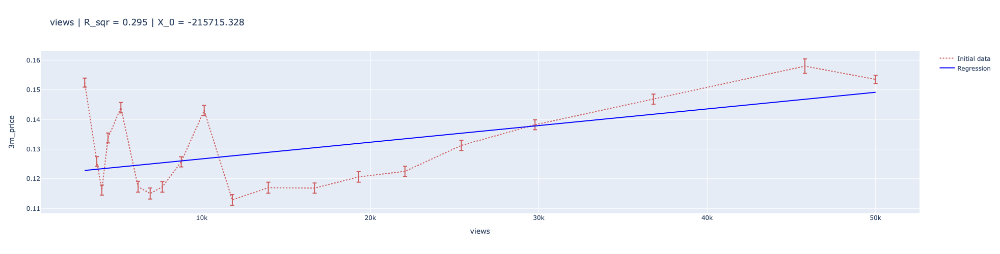

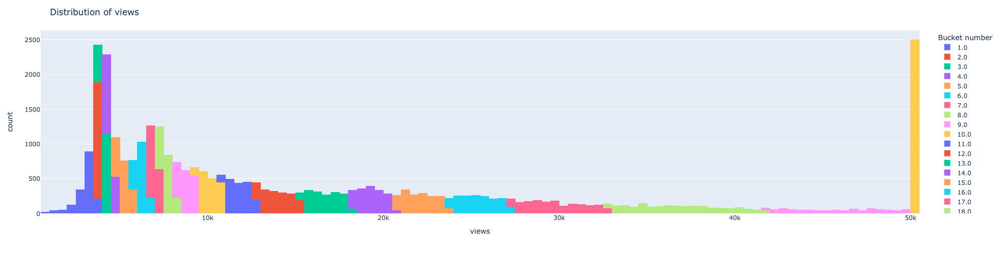

In [21]:
pl.bucket_line(X_train.clip(0, 50000), y, n_buckets=20, feature_name='views', target_name=target, interactive = False)

#### forwards

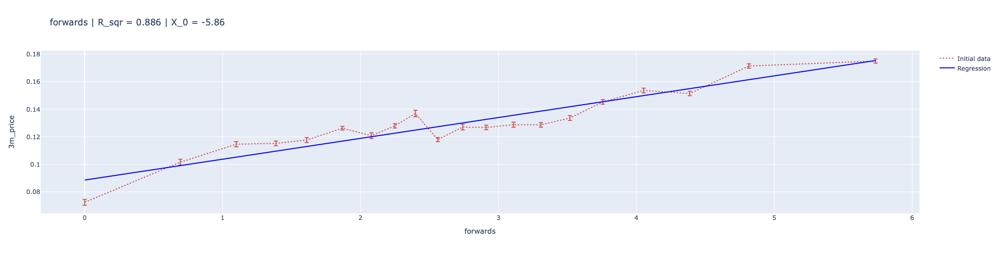

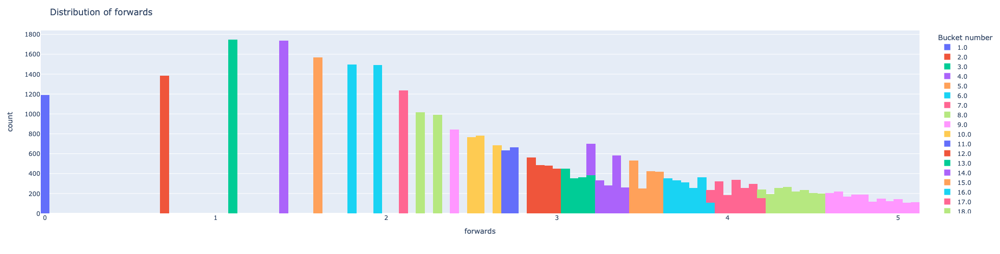

In [22]:
pl.bucket_line(np.log(X_train + 1), y, n_buckets=20, feature_name='forwards', target_name=target, interactive = False)

#### thumb_up_react_cnt

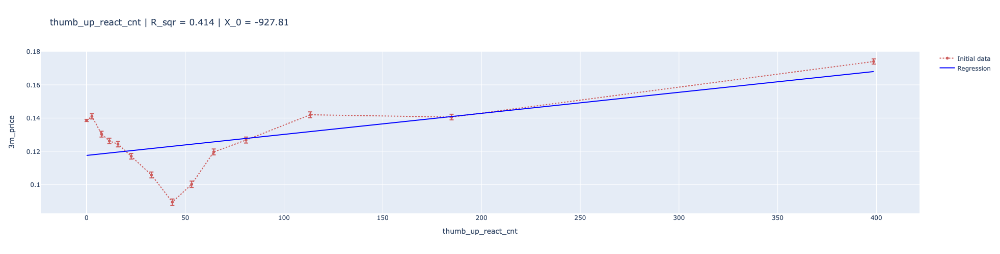

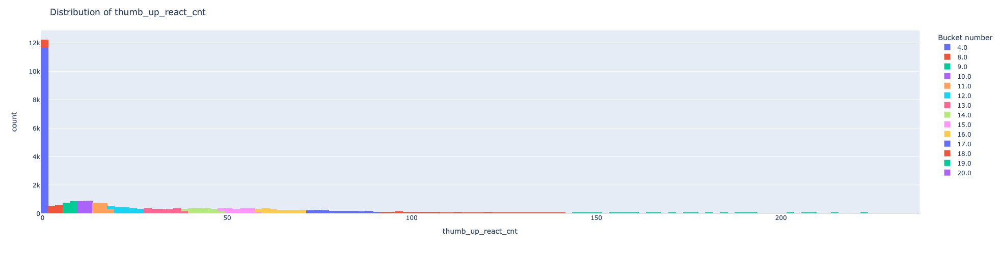

In [24]:
pl.bucket_line(X_train, y, n_buckets=20, feature_name='thumb_up_react_cnt', target_name=target, interactive = False)

#### thumb_down_react_cnt

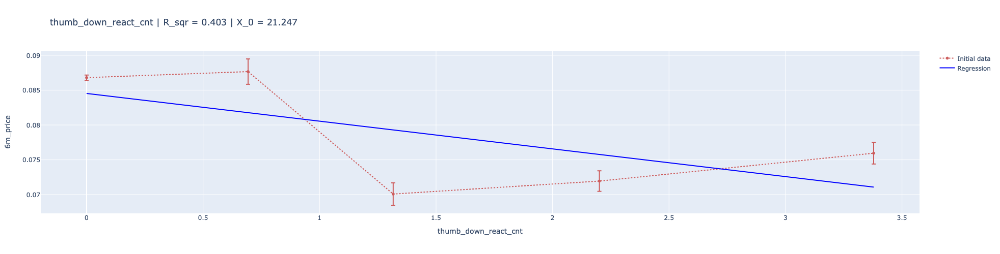

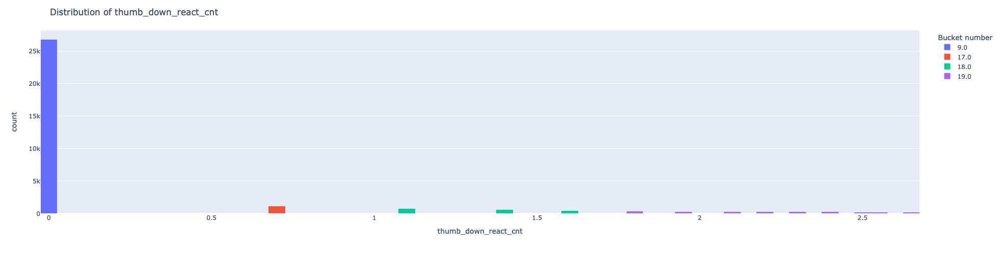

In [34]:
pl.bucket_line(np.log(X_train+1), y, n_buckets=20, feature_name='thumb_down_react_cnt', target_name=target, interactive = False)

#### heart_react_cnt

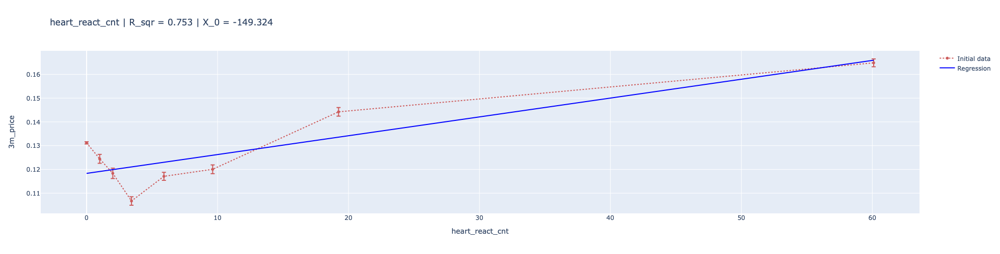

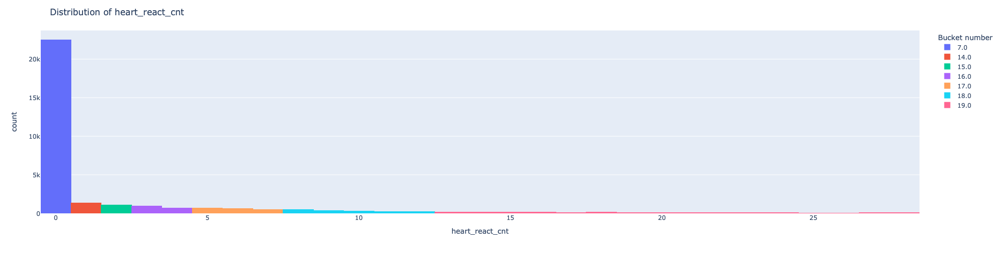

In [25]:
pl.bucket_line(X_train, y, n_buckets=20, feature_name='heart_react_cnt', target_name=target, interactive = False)

#### thinking_react_cnt

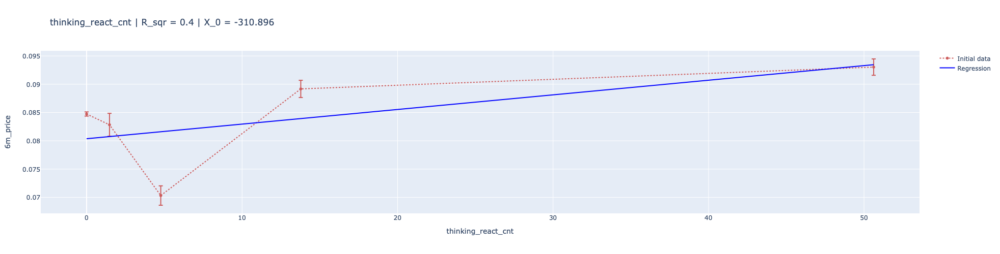

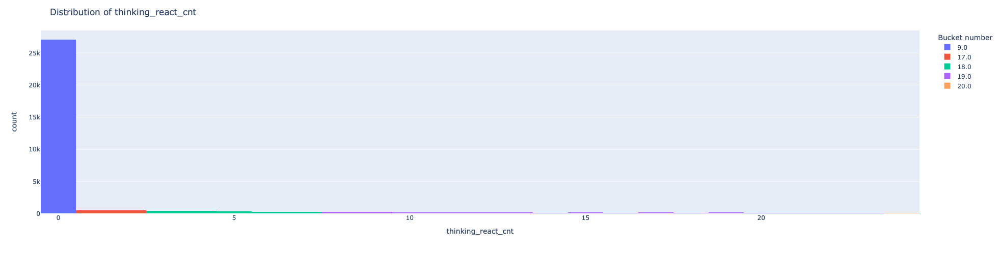

In [37]:
pl.bucket_line(X_train, y, n_buckets=20, feature_name='thinking_react_cnt', target_name=target, interactive = False)

#### crying_react_cnt

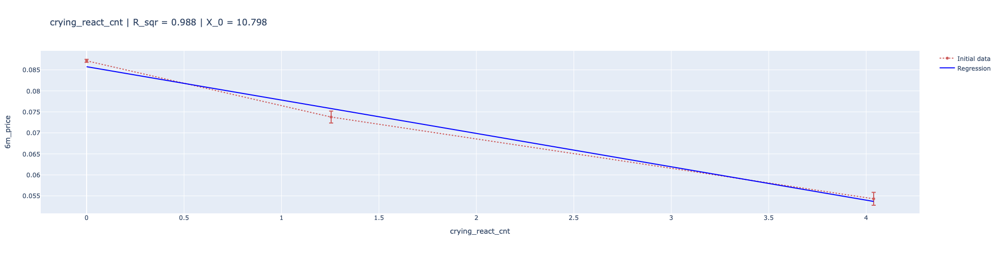

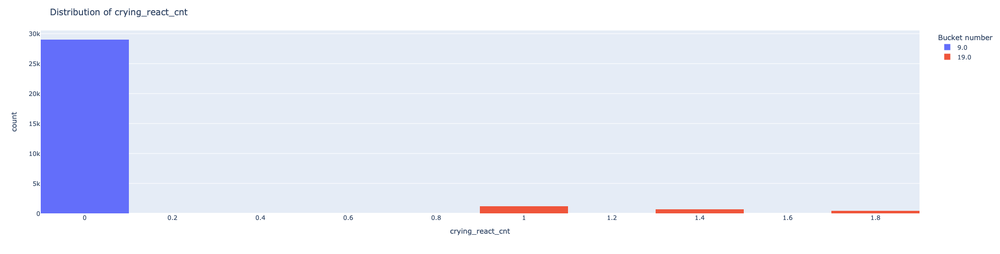

In [39]:
pl.bucket_line(np.sqrt(X_train), y, n_buckets=20, feature_name='crying_react_cnt', target_name=target, interactive = False)

#### fire_react_cnt

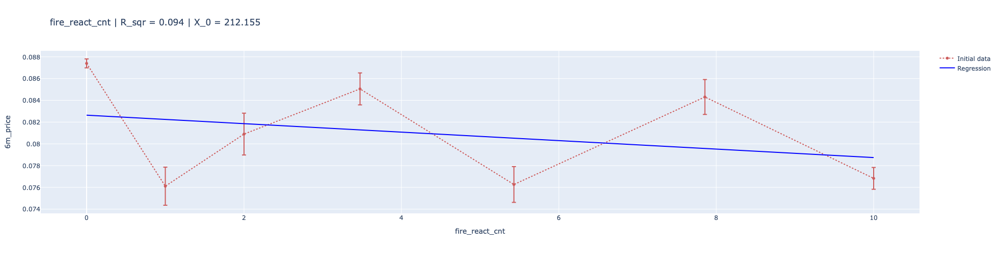

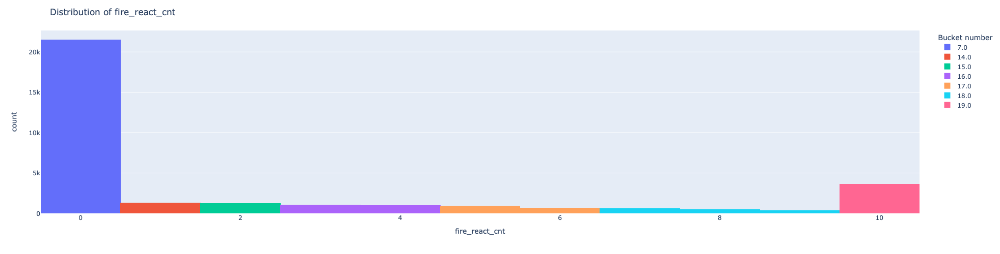

In [40]:
pl.bucket_line(X_train.clip(0, 10), y, n_buckets=20, feature_name='fire_react_cnt', target_name=target, interactive = False)

#### smiling_react_cnt

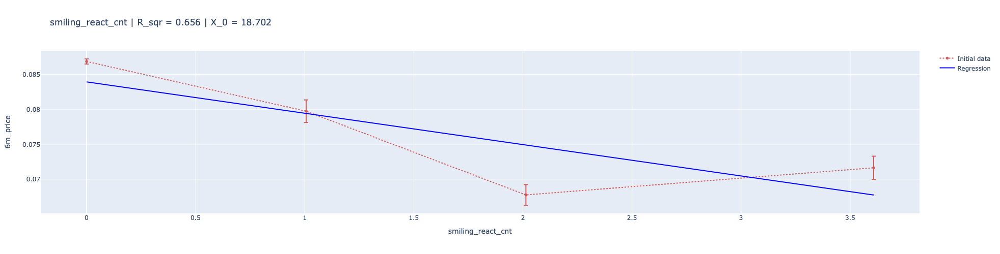

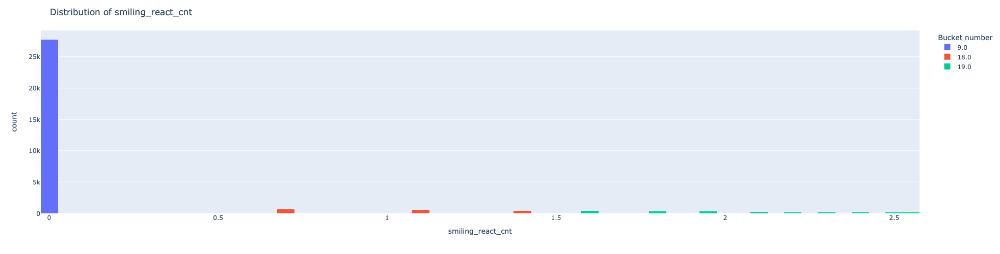

In [48]:
pl.bucket_line(np.log(X_train+1), y, n_buckets=20, feature_name='smiling_react_cnt', target_name=target, interactive = False)

#### days_before_ipo

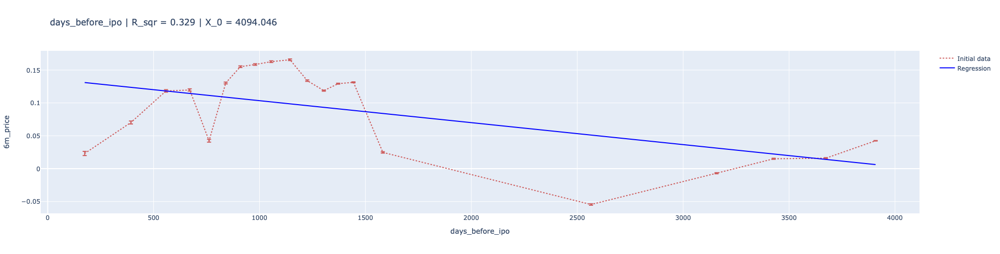

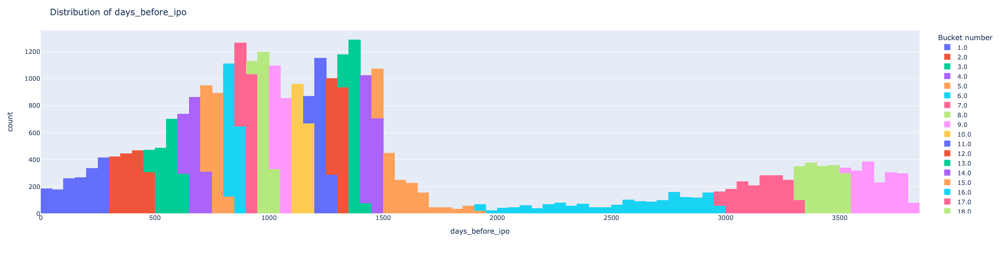

In [41]:
pl.bucket_line(X_train, y, n_buckets=20, feature_name='days_before_ipo', target_name=target, interactive = False)

#### text_len

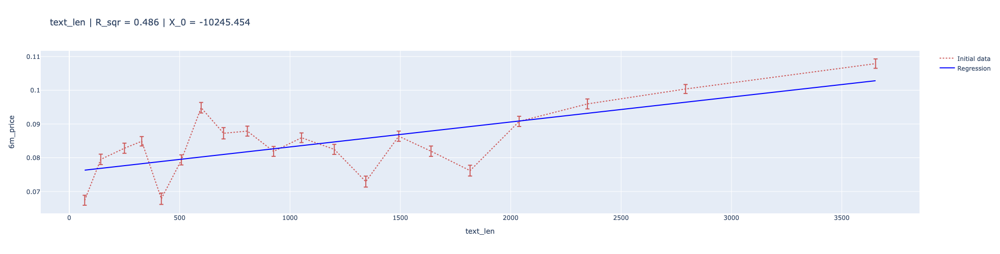

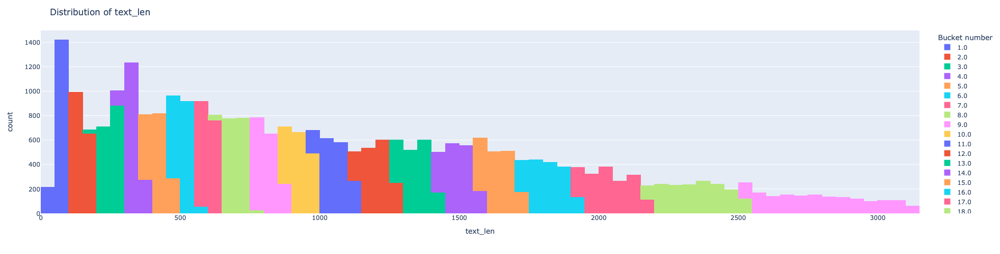

In [42]:
pl.bucket_line(X_train, y, n_buckets=20, feature_name='text_len', target_name=target, interactive = False)

#### delta_price

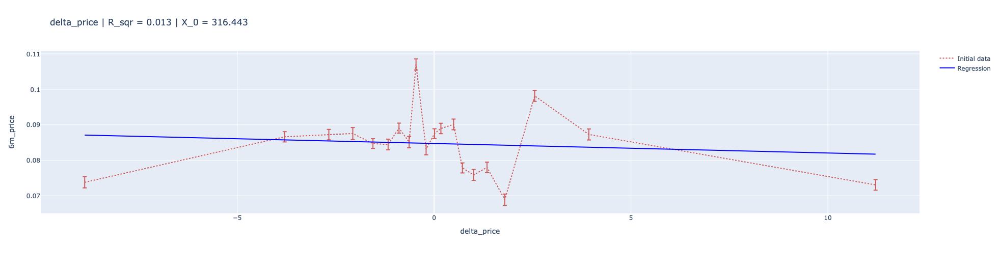

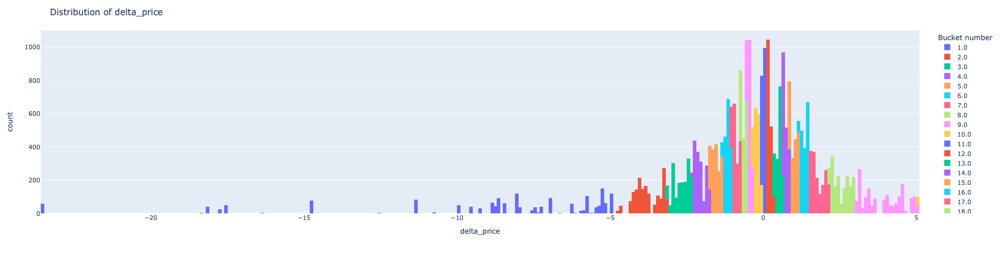

In [49]:
pl.bucket_line(X_train, y, n_buckets=20, feature_name='delta_price', target_name=target, interactive = False)

#### price

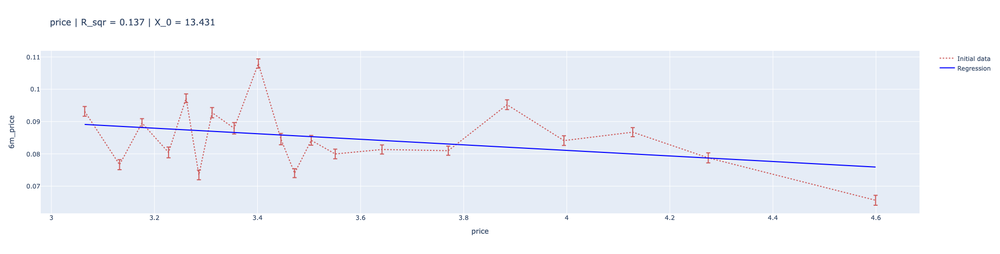

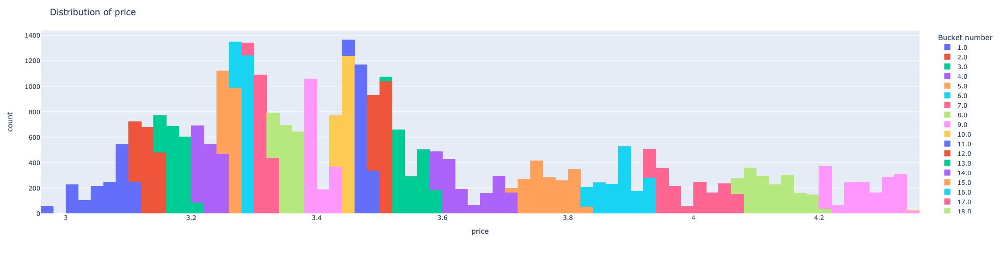

In [43]:
pl.bucket_line(np.log(X_train+1), y, n_buckets=20, feature_name='price', target_name=target, interactive = False)

#### open

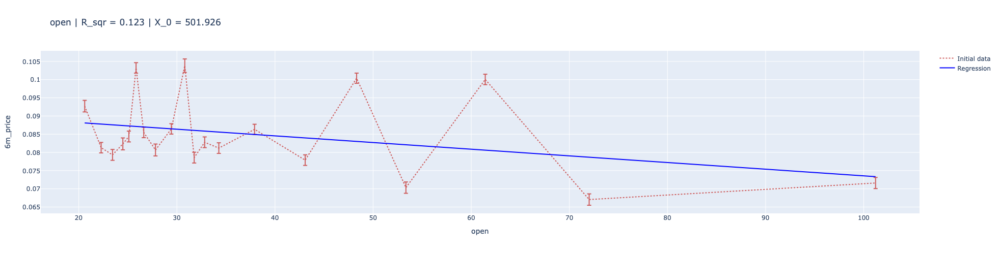

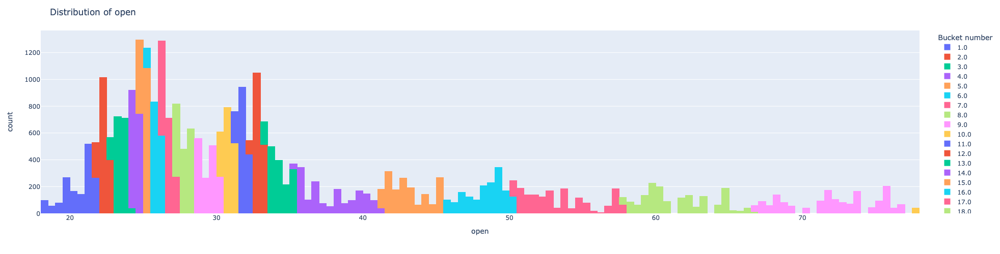

In [51]:
pl.bucket_line(X_train, y, n_buckets=20, feature_name='open', target_name=target, interactive = False)

#### delta_open

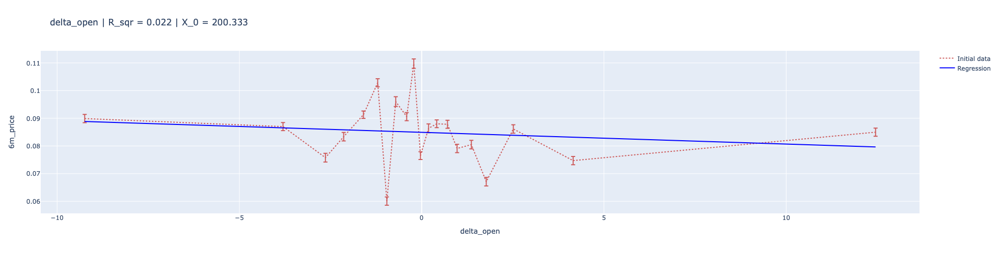

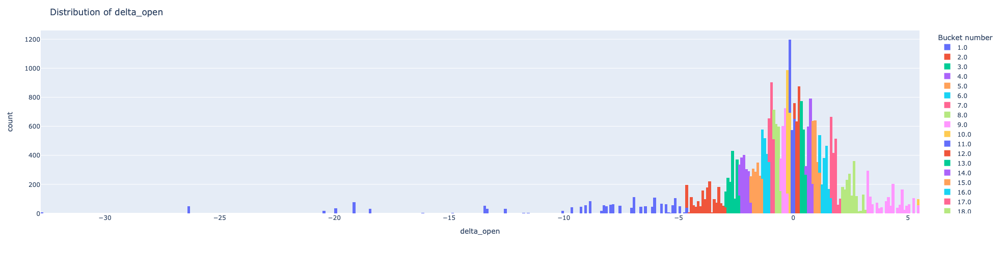

In [52]:
pl.bucket_line(X_train, y, n_buckets=20, feature_name='delta_open', target_name=target, interactive = False)

#### positive_score

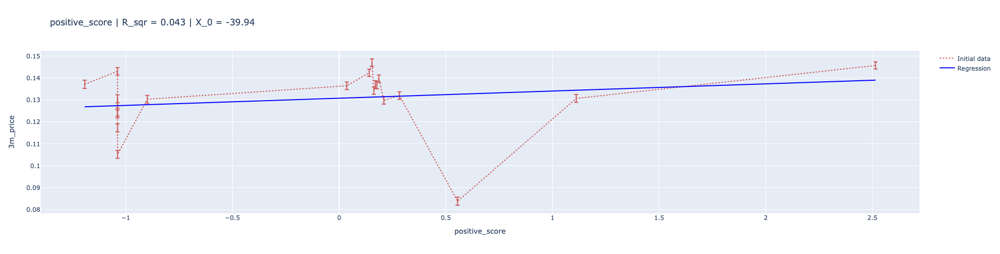

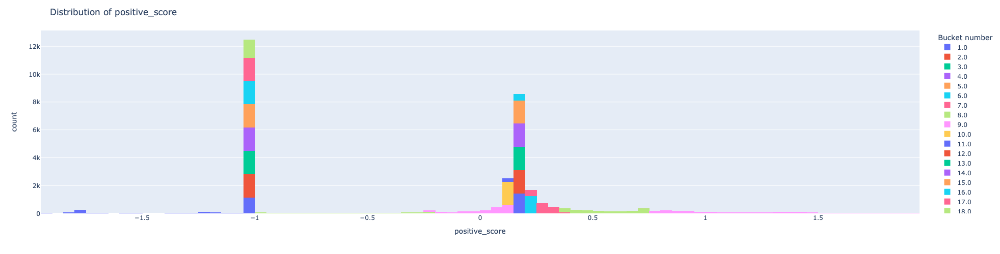

In [32]:
pl.bucket_line(X_train, y, n_buckets=20, feature_name='positive_score', target_name=target, interactive = False)

#### text_len_div_by_days

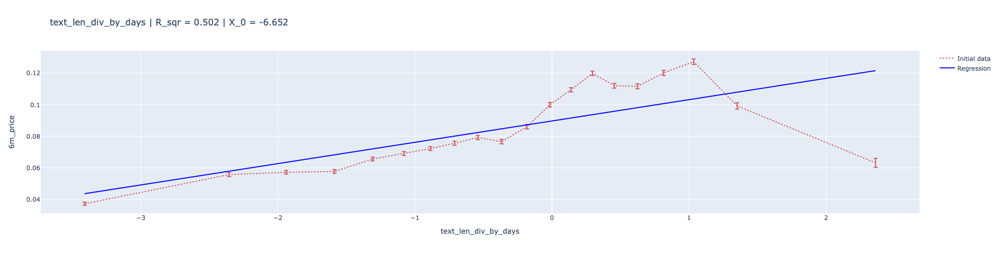

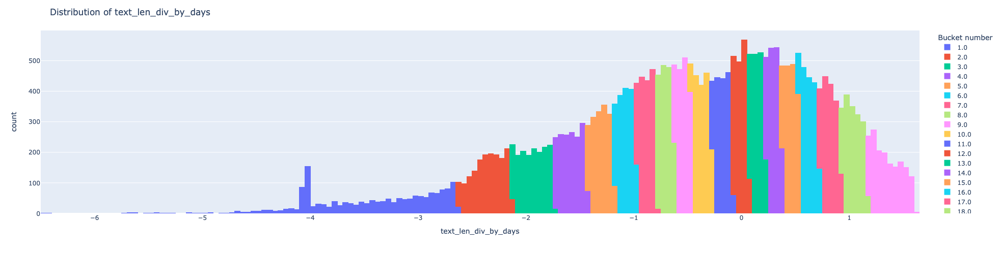

In [53]:
pl.bucket_line(np.log(X_train), y, n_buckets=20, feature_name='text_len_div_by_days', target_name=target, interactive = False)

#### views_div_by_days

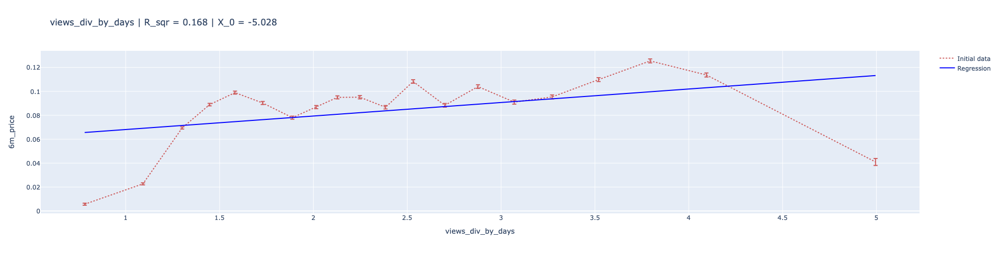

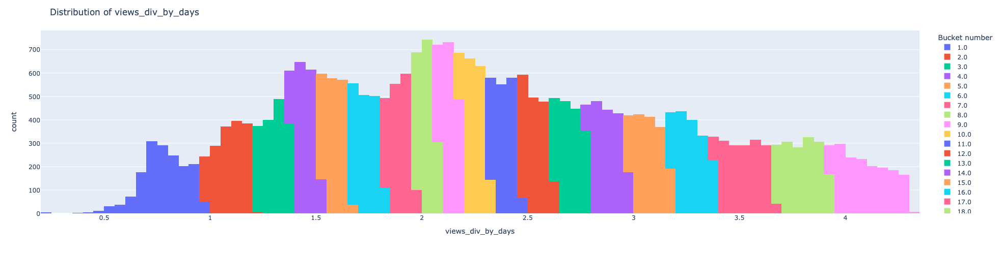

In [54]:
pl.bucket_line(np.log(X_train[['views_div_by_days']]+1), y, n_buckets=20, feature_name='views_div_by_days', target_name=target, interactive = False)

In [58]:
# train
X_train['views'] = X_train['views'].clip(0, 50000)
X_train['forwards'] = np.log(X_train['forwards']+1)

X_train['thumb_down_react_cnt'] = np.log(X_train['thumb_down_react_cnt']+1)
X_train['thumb_up_react_cnt'] = X_train['thumb_up_react_cnt']
X_train['heart_react_cnt'] = X_train['heart_react_cnt']
X_train['thinking_react_cnt'] = X_train['thinking_react_cnt']
X_train['crying_react_cnt'] = np.sqrt(X_train['crying_react_cnt'])
X_train['fire_react_cnt'] = X_train['fire_react_cnt'].clip(0, 10)
X_train['smiling_react_cnt'] = np.log(X_train['smiling_react_cnt'] + 1)

X_train['days_before_ipo'] = X_train['days_before_ipo']

X_train['text_len'] = X_train['text_len']
X_train['price'] = np.log(X_train['price'])
X_train['delta_perc'] = X_train['delta_perc']
X_train['delta_open'] = X_train['delta_open']
X_train['positive_score'] = X_train['positive_score']

X_train['views_div_by_days'] = np.sqrt(X_train['views_div_by_days'])
X_train['text_len_div_by_days'] = np.log(X_train['text_len_div_by_days'])

X_train['views_div_by_days'] = np.log(X_train['views_div_by_days'])
X_train['text_len_div_by_days'] = np.log(X_train['text_len_div_by_days'])


# train
X_test['forwards'] = np.log(X_test['forwards']+1)

X_test['thumb_down_react_cnt'] = np.log(X_test['thumb_down_react_cnt']+1)
X_test['thumb_up_react_cnt'] = X_test['thumb_up_react_cnt']
X_test['heart_react_cnt'] = X_test['heart_react_cnt']
X_test['thinking_react_cnt'] = X_test['thinking_react_cnt']
X_test['crying_react_cnt'] = np.sqrt(X_test['crying_react_cnt'])
X_test['fire_react_cnt'] = X_test['fire_react_cnt'].clip(0, 10)
X_test['smiling_react_cnt'] = np.log(X_test['smiling_react_cnt'] + 1)

X_test['days_before_ipo'] = X_test['days_before_ipo']

X_test['text_len'] = X_test['text_len']
X_test['price'] = np.log(X_test['price'])
X_test['delta_perc'] = X_test['delta_perc']
X_test['delta_open'] = X_test['delta_open']
X_test['positive_score'] = X_test['positive_score']

X_test['views_div_by_days'] = np.sqrt(X_test['views_div_by_days'])
X_test['text_len_div_by_days'] = np.log(X_test['text_len_div_by_days'])

X_test['views_div_by_days'] = np.log(X_test['views_div_by_days'])
X_test['text_len_div_by_days'] = np.log(X_test['text_len_div_by_days'])

### Hard correlation drop

In [59]:
cols = pl.corr_drop(X[cols], y,  0.5)
print(f'{len(cols)} features remain')

11 features remain


In [60]:
model = LinearRegression()

model.fit(X_train[cols], y_train)

y_pred_train = model.predict(X_train[cols])
y_pred_test = model.predict(X_test[cols])

In [61]:
# mape
mape_train = round(mean_absolute_error(y_train, y_pred_train), 4)
mape_test = round(mean_absolute_error(y_test, y_pred_test), 4)

# spearman
spear_train = round(spearmanr(y_train, y_pred_train)[0], 4)
spear_test = round(spearmanr(y_test, y_pred_test)[0], 4)

# pearson
pears_train = round(pearsonr(y_train, y_pred_train)[0], 4)
pears_test = round(pearsonr(y_test, y_pred_test)[0], 4)

# kendaltau
pears_train = round(pearsonr(y_train, y_pred_train)[0], 4)
pears_test = round(pearsonr(y_test, y_pred_test)[0], 4)

cur_res = {'MAPE' : mape_train,
          'Spearman' : spear_train,
          'Pearson' : pears_train,
          'Kendall' : kendall_train}

results = results.append(pd.Series(cur_res,  name = 'after_hard_correlation_drop_train'))

cur_res = {'MAPE' : mape_test,
          'Spearman' : spear_test,
          'Pearson' : pears_test,
          'Kendall' : kendall_test}

results = results.append(pd.Series(cur_res,  name = 'after_hard_correlation_drop_test'))
results

,MAPE,Spearman,Pearson,Kendall
baseline_train,0.1472,0.3693,0.2498,0.2599
baseline_test,0.1598,0.3750,-0.0720,0.2608
after_nonsense_drop_train,0.1476,0.3587,0.2193,0.2599
after_nonsense_drop_test,0.1452,0.3643,0.1684,0.2608
after_soft_correlation_drop_train,0.1483,0.3512,0.1810,0.2599
after_soft_correlation_drop_test,0.1458,0.3544,0.1379,0.2608
after_hard_correlation_drop_train,0.1478,0.3543,0.1588,0.2599
after_hard_correlation_drop_test,0.1447,0.3592,0.1706,0.2608


### Forward selection

In [62]:
train_df = X_train
train_df['target'] = y_train
model = LinearRegression

In [63]:
cols = pl.forward_selection_regression(train_df, cols, model, target='target', alpha_in=0.05)

В модель была добавлена переменная days_before_ipo, p-value: 0.0
В модель была добавлена переменная open, p-value: 0.0
В модель была добавлена переменная crying_react_cnt, p-value: 0.0
В модель была добавлена переменная text_len, p-value: 0.0
В модель была добавлена переменная positive_score, p-value: 0.0004
В модель была добавлена переменная thumb_down_react_cnt, p-value: 0.0021
В модель была добавлена переменная views, p-value: 0.0001
В модель была добавлена переменная smiling_react_cnt, p-value: 0.0037


### Итоговые переменные

In [64]:
print(f'total params:{len(cols)}')
cols

total params:8


['days_before_ipo',
 'open',
 'crying_react_cnt',
 'text_len',
 'positive_score',
 'thumb_down_react_cnt',
 'views',
 'smiling_react_cnt']

### Model

In [65]:
model = LinearRegression()

model.fit(X_train[cols], y_train)

y_pred_train = model.predict(X_train[cols])
y_pred_test = model.predict(X_test[cols])

In [66]:
# mape
mape_train = round(mean_absolute_error(y_train, y_pred_train), 4)
mape_test = round(mean_absolute_error(y_test, y_pred_test), 4)

# spearman
spear_train = round(spearmanr(y_train, y_pred_train)[0], 4)
spear_test = round(spearmanr(y_test, y_pred_test)[0], 4)

# pearson
pears_train = round(pearsonr(y_train, y_pred_train)[0], 4)
pears_test = round(pearsonr(y_test, y_pred_test)[0], 4)

# kendaltau
pears_train = round(pearsonr(y_train, y_pred_train)[0], 4)
pears_test = round(pearsonr(y_test, y_pred_test)[0], 4)

cur_res = {'MAPE' : mape_train,
          'Spearman' : spear_train,
          'Pearson' : pears_train,
          'Kendall' : kendall_train}

results = results.append(pd.Series(cur_res,  name = 'model_train'))

cur_res = {'MAPE' : mape_test,
          'Spearman' : spear_test,
          'Pearson' : pears_test,
          'Kendall' : kendall_test}

results = results.append(pd.Series(cur_res,  name = 'model_test'))
results

,MAPE,Spearman,Pearson,Kendall
baseline_train,0.1472,0.3693,0.2498,0.2599
baseline_test,0.1598,0.3750,-0.0720,0.2608
after_nonsense_drop_train,0.1476,0.3587,0.2193,0.2599
after_nonsense_drop_test,0.1452,0.3643,0.1684,0.2608
after_soft_correlation_drop_train,0.1483,0.3512,0.1810,0.2599
after_soft_correlation_drop_test,0.1458,0.3544,0.1379,0.2608
after_hard_correlation_drop_train,0.1478,0.3543,0.1588,0.2599
after_hard_correlation_drop_test,0.1447,0.3592,0.1706,0.2608
model_train,0.1478,0.3535,0.1587,0.2599
model_test,0.1447,0.3588,0.1706,0.2608


In [67]:
results.to_csv('results/6m_regression.csv')

In [69]:
import statsmodels.api as sm

model = sm.OLS(y, X[cols])
results = model.fit()
results = results.summary()
results

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:               6m_price   R-squared (uncentered):                   0.102
Model:                            OLS   Adj. R-squared (uncentered):              0.102
Method:                 Least Squares   F-statistic:                              581.3
Date:                Thu, 02 May 2024   Prob (F-statistic):                        0.00
Time:                        00:38:51   Log-Likelihood:                          284.50
No. Observations:               40845   AIC:                                     -553.0
Df Residuals:                   40837   BIC:                                     -484.1
Df Model:                           8                                                  
Covariance Type:            nonrobust                                                  
========================================================================================
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
days_before_ipo      -1.127e-05   9.08e-07    -12.414      0.000   -1.31e-05   -9.49e-06
open                     0.0013   4.32e-05     29.047      0.000       0.001       0.001
crying_react_cnt        -0.0002   8.87e-05     -2.170      0.030      -0.000   -1.86e-05
text_len              2.713e-05    1.2e-06     22.588      0.000    2.48e-05    2.95e-05
positive_score           0.0070      0.001      5.270      0.000       0.004       0.010
thumb_down_react_cnt    -0.0003   7.79e-05     -4.014      0.000      -0.000      -0.000
views                 4.558e-07   4.69e-08      9.718      0.000    3.64e-07    5.48e-07
smiling_react_cnt     5.845e-05   5.45e-05      1.073      0.283   -4.83e-05       0.000
==============================================================================
Omnibus:                     7394.666   Durbin-Watson:                   1.629
Prob(Omnibus):                  0.000   Jarque-Bera (JB):           168292.930
Skew:                          -0.221   Prob(JB):                         0.00
Kurtosis:                      12.934   Cond. No.                     3.58e+04
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[3] The condition number is large, 3.58e+04. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [76]:
import pickle
 
with open("results/6m_regression.pickle", "wb") as file:
    pickle.dump(results, file)